<a href="https://colab.research.google.com/github/your-username/your-repo/blob/main/your-notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



# Geostatistical Analysis and Web GIS Application for Tracking Urban-Rural Remote Work Migration Post-COVID

---

## Introduction
The COVID-19 pandemic has reshaped global work patterns, with remote work emerging as a dominant mode of employment. This project examines how these shifts have influenced migration trends between urban and rural areas, focusing on wage levels, economic activity, and sectoral changes. Geostatistical techniques, combined with a Web GIS platform, are employed to provide actionable insights for policymakers addressing post-COVID economic transformations.

---

## Literature Review
The literature review, summarized in [Appendix A](https://github.com/ArcturusMajere/finalgeog/blob/main/appendix%20A.pdf), provides a comprehensive analysis of remote work trends, urban-rural migration, and wage disparities during the pandemic. It highlights the structural changes in the labor market and their spatial impacts.

---

## Remote Work Trends (2016–2022)
This section explores temporal and spatial patterns of remote work across U.S. counties using ACS data from 2016 to 2022. Animated and static visualizations showcase the evolving distribution and intensity of remote work over time.

---

## Mapping Remote Work Trends in U.S. Counties: Animating ACS Data (2016–2022)
Using animated maps, this section visualizes the progression of remote work intensity across counties, identifying regions with the most significant changes and providing insights into emerging patterns.

---

## Track Migration Across Urban and Rural Areas
This section investigates the migration of remote workers, analyzing wage impacts, sectoral changes, and economic dynamics in urban and rural regions. Geostatistical methods are employed to identify and quantify these patterns.

---

## Develop a Web GIS Platform
This section details the creation of an interactive Web GIS platform to visualize migration trends, wage disparities, and sectoral transitions. Features such as distributive flow maps enhance data accessibility and decision-making capabilities.

---

## Submit Report
The final section outlines the preparation of a comprehensive report, including methodologies, findings, and conclusions. It integrates insights from the Web GIS platform and the annotated bibliography to provide actionable recommendations.

---

# Table of Contents

- [Introduction](#introduction)
- [Literature Review](#literature-review)
- [Remote Work Trends (2016–2022)](#remote-work-trends-2016–2022)
- [Mapping Remote Work Trends in U.S. Counties: Animating ACS Data (2016–2022)](#mapping-remote-work-trends-in-us-counties-animating-acs-data-2016-2022)
- [Track Migration Across Urban and Rural Areas](#track-migration-across-urban-and-rural-areas)
- [Develop a Web GIS Platform](#develop-a-web-gis-platform)


In [11]:
# Cool Package checker.. 
try:
    import subprocess
    import sys
    import importlib.util
except ImportError as e:
    print(f"install the above helpers!: {e}")

def install_package(package_name):
    if importlib.util.find_spec(package_name) is None:
        print(f"Package {package_name} not found. Installing...")
        subprocess.check_call([sys.executable, "-m", "pip", "install", package_name])
    else:print(f"Package {package_name} is already installed.")

def install_and_import_all():
    packages = ["matplotlib", "seaborn", "requests", "censusdata", "census", "us","io",
                "mapclassify", "pandas", "geopandas", "pygris", "mpl_toolkits", "folium", "panel", "plotly", 
                "shapely", "cartopy"]
    for package in packages:
        install_package(package)
    print("All required packages installed and successfully.")
install_and_import_all()
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.animation import FuncAnimation
import matplotlib.image as mpimg
import requests
import censusdata
from census import Census
from us import states
import pandas as pd
import geopandas as gpd
from pygris import counties
from mpl_toolkits.axes_grid1 import make_axes_locatable
import folium
import time
import os;
import censusdata
import panel as pn
import plotly.express as px
from shapely.geometry import LineString
import plotly.graph_objects as go
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable, get_cmap
from IPython.display import display, HTML, clear_output
import matplotlib.dates as mdates
from io import BytesIO

# its mine.. but not critically important as I can get another key issued. 
api_key = "2a2f8febfd3cdfeebbaaa1e54064cff81232875c"
import warnings;warnings.filterwarnings("ignore")
%matplotlib inline

Package matplotlib is already installed.
Package seaborn is already installed.
Package requests is already installed.
Package censusdata is already installed.
Package census is already installed.
Package us is already installed.
Package io is already installed.
Package mapclassify is already installed.
Package pandas is already installed.
Package geopandas is already installed.
Package pygris is already installed.
Package mpl_toolkits is already installed.
Package folium is already installed.
Package panel is already installed.
Package plotly is already installed.
Package shapely is already installed.
Package cartopy is already installed.
All required packages installed and successfully.


#  Section 1
## Remote Work Trends (2016–2022)

## Overview
This analysis examines the rise in remote work trends across the United States from 2016 to 2022. Using data from the American Community Survey (ACS), the percentage of workers who worked from home each year was calculated and visualized.

## Methods
1. **Data Collection:**
   - Data for total commuters (`B08006_001E`) and workers who worked from home (`B08006_017E`) was retrieved for each U.S. county from the ACS 5-Year estimates for the years 2016 to 2022.
2. **Percentage Calculation:**
   - For each county and year, the percentage of remote workers was calculated as:
     \[
     \text{Remote Work Percentage} = \left(\frac{\text{Worked from Home}}{\text{Total Commuters}}\right) \times 100
     \]
3. **Trend Analysis:**
   - The average remote work percentage was computed at the national level for each year.
4. **Visualization:**
   - A line plot was generated to display the yearly average remote work percentages from 2016 to 2022.

## Results
- **Steady Growth:**
  - Remote work percentage exhibited steady growth between 2016 and 2019, reflecting gradual adoption of flexible work practices.
- **Sharp Increase (2020–2022):**
  - A significant spike in remote work occurred from 2020 onwards, coinciding with the COVID-19 pandemic and the resulting shift to remote work environments.
- **Peak in 2022:**
  - By 2022, the national average for remote work reached its highest level, reflecting sustained adoption of remote work practices even as pandemic-related restrictions eased.

## Conclusion
The data underscores the epic impact of the COVID-19 pandemic on work patterns in the U.S., with a dramatic shift toward remote work. The continued upward trend post-2020 suggests a lasting change in the workforce landscape, with remote work becoming a normalized aspect of many industries. Future analysis could explore state or sector-level variations and the long-term implications of this shift.

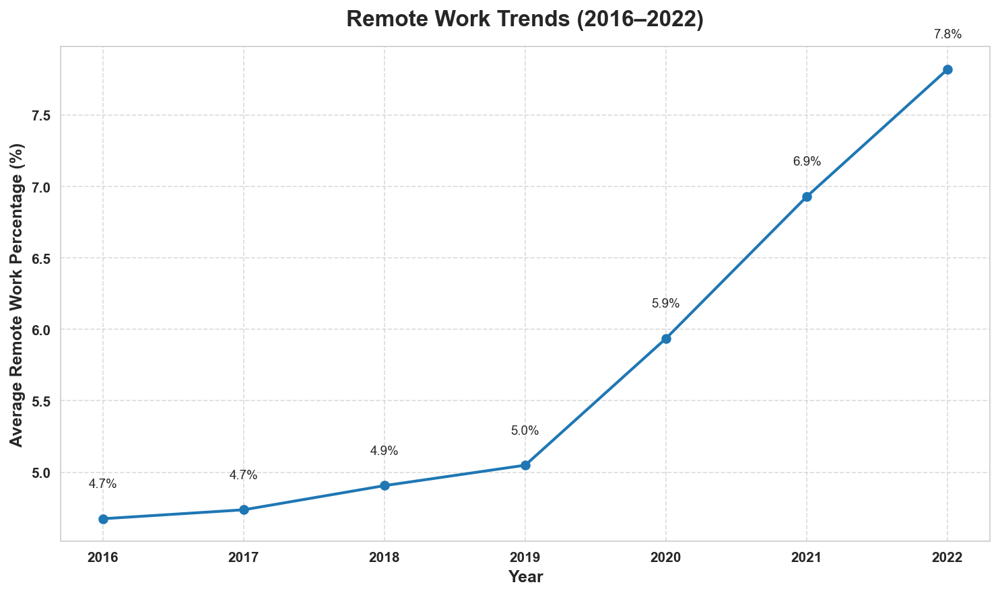

In [9]:
variables = {'B08006_001E': 'Total Commuters', 'B08006_017E': 'Worked from Home'}
dataframes = []
for year in range(2016, 2023):
    df = censusdata.download('acs5',
                             year,
                             censusdata.censusgeo([('state', '*'), ('county', '*')]),
                             list(variables.keys()))
    df.rename(columns=variables, inplace=True)
    df['Year'] = year
    dataframes.append(df)
remote_work_data = pd.concat(dataframes).reset_index()
remote_work_data.rename(columns={'index': 'Geography'}, inplace=True)
remote_work_data['Remote_Work_Percentage'] = remote_work_data['Worked from Home'] / remote_work_data['Total Commuters'] * 100
yearly_trends = remote_work_data.groupby('Year', as_index=False)['Remote_Work_Percentage'].mean()
sns.set_style("whitegrid")
plt.figure(figsize=(10, 6), dpi=150)
plt.plot(yearly_trends['Year'],
         yearly_trends['Remote_Work_Percentage'],
         marker='o',
         color='#1f77b4',
         linewidth=2,
         markersize=6)

for x, y in zip(yearly_trends['Year'], yearly_trends['Remote_Work_Percentage']):
    plt.text(x, y + 0.2, f"{y:.1f}%", ha='center', va='bottom', fontsize=9)

plt.title('Remote Work Trends (2016–2022)', fontsize=16, fontweight='bold', pad=15)
plt.xlabel('Year', fontsize=12, fontweight='bold')
plt.ylabel('Average Remote Work Percentage (%)', fontsize=12, fontweight='bold')
plt.xticks(fontsize=10, fontweight='bold')
plt.yticks(fontsize=10, fontweight='bold')
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Section 2
## Mapping Remote Work Trends in U.S. Counties: Animating ACS Data (2016–2022)

This project provides a spatial analysis of remote work trends across U.S. counties, using data from the American Community Survey (ACS) from 2016 to 2022. 

## Section Overview

This project aims to visualize the intensity and evolution of remote work across the U.S. from 2016 to 2022. 

Key components of the analysis include:

- **Data Collection**: 
  - **ACS Data**: Fetching annual data from the ACS API on remote work and total work hours per county, normalizing these values to show remote work intensity over time.

  
- **Geographic Mapping**:
  - **Normalized Remote Work Intensity**: Visualizing the proportion of remote work hours relative to total work hours across U.S. counties using pygris and geopandas.

## Visualization Options

This notebook includes two visualization approaches:

1. **Static Grid of Maps**: Displays annual maps in a grid layout, allowing for side-by-side comparison of remote work intensity across multiple years.
2. **Animated Map Sequence**: Shows the progression of remote work intensity over time, capturing year-over-year shifts in a dynamic way. HPS data can be overlaid to provide additional context.

## Data Sources

- **American Community Survey (ACS)**: Data on remote work hours and total work hours, retrieved via the U.S. Census Bureau API.


## Requirements

To run this analysis, you will need:

- **API Key**: A valid U.S. Census API key to access ACS and HPS data.
- **Python Libraries**:
  - `requests`: For data retrieval from the ACS and HPS APIs.
  - `pandas` and `geopandas`: For data handling and geographic processing.
  - `matplotlib` and `mpl_toolkits.axes_grid1`: For plotting and map customization.
  - `pygris`: For accessing U.S. county shapefiles.

## Remote Work Trends by County

### Dataset Description:
This analysis uses data from the **American Community Survey (ACS)** and shapefiles from the **TIGER/Line GIS database** to explore **remote work trends across U.S. counties**. The data includes:
- **B08006_017E**: Total number of people working remotely in each county.
- **B08006_001E**: Total workforce in each county.
- **normalized_remote_hours**: The ratio of remote workers to the total workforce, providing a normalized measure of remote work intensity for each county.

This dataset spans from **2016 to 2022**, capturing the geographic evolution of remote work trends over time.

### Objective:
The primary goal is to visualize and understand the spatial distribution of remote work intensity across counties in the United States for a selected year. The interactive map allows users to analyze trends for each year between 2016 and 2022.

### Methodology:
1. **Data Retrieval**:
   - ACS data is fetched via the Census Bureau's API for the selected year.
   - Remote work intensity is calculated by normalizing the number of remote workers by the total workforce for each county.

2. **Geospatial Mapping**:
   - County-level shapefiles are retrieved using the `pygris` library.
   - The ACS data is merged with county shapefiles to create a GeoDataFrame, enabling geospatial plotting.
   - The map displays the normalized remote work intensity using a **quantile classification scheme**.

3. **Interactive Dashboard**:
   - An interactive slider allows users to select the year of interest.
   - The map dynamically updates to display remote work intensity for the selected year.

### Observations:
1. **Times Trends**:
   - Remote work intensity experienced a significant increase in 2020 and 2021, coinciding with the COVID-19 pandemic. Many counties across the U.S. adopted remote work policies during this period.
   - By 2022, remote work intensity stabilized in some regions, reflecting the adoption of hybrid work models or the return to in-office work in certain sectors.

2. **Regional Differences**:
   - Urban counties, especially those with strong tech, finance, and professional service industries, consistently show higher remote work intensity like counties surrounding Silicon Valley, New York City, and Washington, D.C.
   - Rural counties with agriculture, manufacturing, and service-based economies show lower remote work adoption due to the nature of their industries.

3. **Geographic Clusters**:
   - Remote work hotspots emerged in the **Northeast Corridor**, **West Coast**, and parts of the **Midwest**, driven by the concentration of remote-friendly industries in these regions.
   - The **South** and more rural parts of the **Great Plains** demonstrated lower adoption rates.

### Implications:
1. **Infrastructure Development**:
   - Policymakers should focus on improving broadband access and digital infrastructure in rural and underserved areas to support remote work capabilities.

2. **Economic Shifts**:
   - Regions with high remote work intensity may see population shifts as individuals relocate for affordability or lifestyle preferences, impacting housing markets, local economies, and transportation policies.

3. **Workforce Strategies**:
   - Businesses can leverage these insites to optimize workforce planning, expand talent acquisition efforts in high-adoption regions, and adapt to the changing dynamics of hybride work models.


### Conclusion:
The geospatial analysis of normalized remote work intensity reveals how counties across the United States adapted to the changing work landscape. Urban centers led the adoption of remote work, while rural areas lagged due to infrastructure and industry constraints. This dashboard provides a powerful tool for visualizing  trends and guiding data-driven decisions for policymakers, businesses, and researchers, hopefully.


Processing data for 2012...
Processing data for 2013...
Processing data for 2014...
Processing data for 2015...
Processing data for 2016...
Processing data for 2017...
Processing data for 2018...
Processing data for 2019...
Processing data for 2020...
Processing data for 2021...
Processing data for 2022...
Maps have been created and saved for each year.


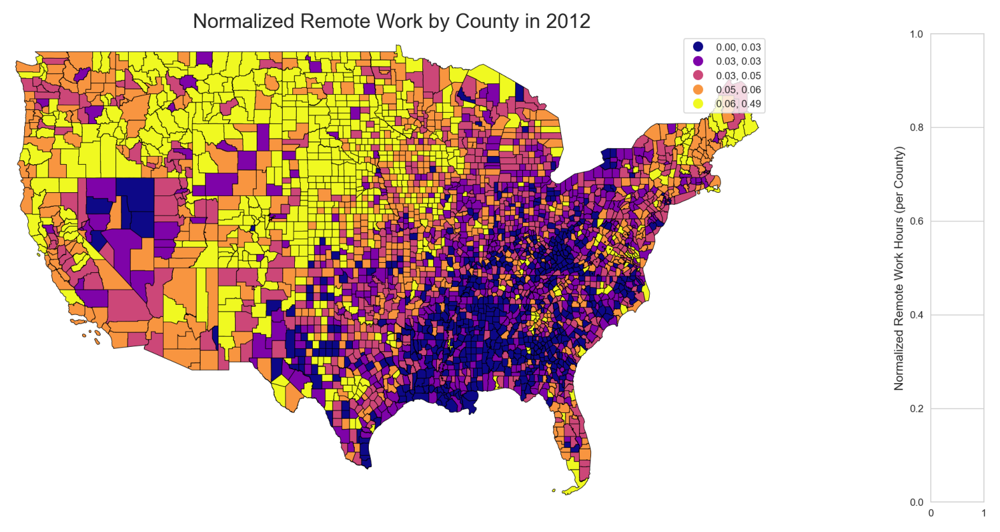

In [10]:
years = range(2012, 2023)

def fetch_acs_data(year, api_key):
    base_url = f"https://api.census.gov/data/{year}/acs/acs5"
    params = { "get": "NAME,B08006_017E,B08006_001E",  "for": "county:*","in": "state:*","key": api_key}
    response = requests.get(base_url, params=params)
    if response.status_code == 200:
        data = response.json()
        columns = data[0]
        df = pd.DataFrame(data[1:], columns=columns)
        df["B08006_017E"] = pd.to_numeric(df["B08006_017E"], errors="coerce")
        df["B08006_001E"] = pd.to_numeric(df["B08006_001E"], errors="coerce")
        df["state+county"] = df["state"] + df["county"]
        df["normalized_remote_hours"] = df["B08006_017E"] / df["B08006_001E"]
        return df
    else:
        print(f"Failed to fetch data for {year}. Status code: {response.status_code}")
        return pd.DataFrame()
# ANAIMATE
def update(frame):
    img = mpimg.imread(output_files[frame])
    ax.clear() 
    ax.imshow(img)
    ax.axis('off') 
    title.set_text(f"Year: {2016 + frame}")  
output_files = []
for year in years:
    print(f"Processing data for {year}...")
    df = fetch_acs_data(year, api_key)
    if df.empty:
        continue
    counties_df = counties(year=year, cache=True)
    counties_df["GEOID"] = counties_df["STATEFP"] + counties_df["COUNTYFP"]
    gdf = counties_df.merge(df, left_on="GEOID", right_on="state+county")
    if gdf.empty:
        print(f"No merged data available for {year}")
        continue
    fig, ax = plt.subplots(figsize=(20, 15)) 
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)  
    gdf_plot = gdf.plot(column="normalized_remote_hours",  cmap="plasma", legend=True, 
        edgecolor="black", linewidth=0.5,scheme="Quantiles",k=5,ax=ax,cax=cax)
    cbar = gdf_plot.get_figure().get_axes()[-1]  
    cbar.set_ylabel("Normalized Remote Work Hours (per County)", fontsize=12)
    ax.set_xlim([-125, -66])  
    ax.set_ylim([24, 50])     
    ax.set_title(f"Normalized Remote Work by County in {year}", fontsize=20)
    ax.axis('off')
    file_name = f"normalized_remote_work_{year}.png"
    plt.savefig(file_name, bbox_inches='tight', dpi=150)  
    output_files.append(file_name)
    plt.close()
print("Maps have been created and saved for each year.")
fig, ax = plt.subplots(figsize=(20, 15))
ax.axis('off')  
title = ax.set_title("Normalized Remote Work by County Over Time", fontsize=20)
anim = FuncAnimation(fig, update, frames=len(output_files), interval=2000)  # 2-second interval
HTML(anim.to_jshtml())


# Section 3
## Analysis of Remote Work Trends Across Occupations

## Dataset Description:
The dataset contains information on the percentage of remote work across various occupations. It is organized by:
- **Year** and **Month**: The time periods for data aggregation.
- **SOC 2018 3-Digit Minor Group (Name)**: Occupational groups as defined by the U.S. Standard Occupational Classification system.
- **Percent**: The average percentage of remote work for each occupation in a given period.

The dataset provides insights into the temporal dynamics of remote work adoption for different job categories.

## Objective:
The goal of this analysis is to identify and visualize the **top 10 largest changes in remote work percentages** for occupational groups across consecutive quarters.

## Methodology:
1. **Data Aggregation**:
   - Remote work percentages were grouped by quarter and occupation.
   - Absolute changes in percentages were calculated for consecutive quarters.

2. **Filtering for Significant Changes**:
   - For each quarter, the top 10 occupations with the largest changes in remote work were identified.

3. **Visualization**:
   - An animated pie chart was created to illustrate the magnitude of these changes.
   - Each slice of the pie chart represents an occupation, with slice size proportional to the percentage change.

## Conclusions:
- The analysis reveals occupations with the most significant shifts in remote work percentages over time.
- Insights from the visualization can help identify job categories experiencing rapid remote work adoption or decline.
- This provides valuable information for policymakers, organizations, and workforce analysts.

## Interactive Features:
- The animated pie chart allows users to explore how occupational trends evolved across quarters.
- Controls (Play/Pause) and sliders enhance the interactivity of the visualization.


## Winners and Losers in Remote Work Trends

### Winners: Occupations with Significant Growth in Remote Work Adoption
1. **High-Growth Occupations**:
   - **Information Technology (IT)** roles, such as software developers and computer system analysts, consistently show high increases in remote work adoption. These roles easily adapt to remote settings due to their reliance on digital tools.
   - **Financial Analysts and Accountants** also experienced notable growth in remote work percentages as financial services embraced digital platforms.
   - **Management Positions** (e.g., Top Executives) adjusted well to virtual collaboration, ensuring strategic operations continued seamlessly.

2. **Industry-Specific Trends**:
   - **Education roles**, particularly postsecondary teachers, saw spikes in remote work adoption during the pandemic due to the rapid shift to online education platforms.
   - **Healthcare Support Occupations**, such as medical transcriptionists, experienced moderate increases, reflecting the rise of telehealth services.

3. **Temporal Insights**:
   - The most significant increases in remote work adoption occurred during the COVID-19 pandemic (2020 Q2–2021 Q1), as global remote work policies were implemented.
   - IT roles continued to grow even in the post-pandemic era, solidifying remote work as a long-term trend in the sector.

---

### Losers: Occupations with Declines or Limited Remote Work Adoption
1. **Low-Growth Occupations**:
   - **Food Preparation and Serving Occupations** (e.g., cooks and food servers) showed minimal remote work adoption due to their physical nature.
   - **Construction and Extraction Workers** and **Transportation and Material Moving Occupations** (e.g., drivers) demonstrated negligible or declining adoption rates, reflecting the hands-on demands of their jobs.

2. **Significant Declines**:
   - **Administrative Support Occupations** (e.g., clerks) saw declines in remote work percentages as businesses transitioned back to in-office setups or automated tasks.
   - **Retail Sales Roles** experienced reductions as in-person activities resumed post-pandemic.

3. **Persistent In-Person Work**:
   - **Healthcare Practitioners and Technicians** (e.g., nurses, paramedics) were largely unaffected by remote work trends due to their critical in-person responsibilities.
   - **Manufacturing Occupations** showed limited remote work adoption, as production lines require on-site operation.

---

## Key Trends and Observations
1. **Remote-Ready vs. In-Person Roles**:
   - Remote-ready occupations, such as IT and finance roles, thrived during the pandemic and solidified remote work practices.
   - In-person roles, such as those in healthcare and construction, lagged behind due to their inherent physical requirements.

2. **Uneven Recovery**:
   - While remote work adoption stabilized for some occupations post-pandemic, others returned to traditional setups or experienced declines.

3. **Adaptability as a Success Factor**:
   - Occupations that leveraged technology emerged as winners.
   - Jobs dependent on physical tools or on-site activities faced inherent constraints in adopting remote work.

---

## Implications for Policymakers and Organizations
1. **Workforce Planning**:
   - Reskilling and upskilling programs are essential for workers in occupations with declining remote work adoption.
   - Investments in digital tools for less adaptable sectors can mitigate disparities.

2. **Policy Adjustments**:
   - Sustained remote work sectors (e.g., IT and finance) benefit from policies supporting long-term remote infrastructure.
   - Hybrid models and workforce safety regulations can address the needs of in-person roles.

3. **Talent Acquisition and Retention**:
   - Remote-ready sectors will face global competition for talent, requiring organizations to innovate in recruitment and retention strategies.
   - Additional incentives may be necessary to retain workers in in-person roles, given their limited access to remote options.

---


In [12]:
# Data on my GitHub
file_url = 'https://github.com/ArcturusMajere/finalgeog/raw/main/remote_work_in_job_ads_public_data.xlsx'
response = requests.get(file_url)
file_content = BytesIO(response.content)
data = pd.ExcelFile(file_content)
occupation_by_month_df = data.parse('occupation_by_month')
month_mapping = {'Jan': 1, 'Feb': 2, 'Mar': 3, 'Apr': 4, 'May': 5, 'Jun': 6,
                 'Jul': 7, 'Aug': 8, 'Sep': 9, 'Oct': 10, 'Nov': 11, 'Dec': 12}

occupation_by_month_df['Month_Num'] = occupation_by_month_df['Month'].map(month_mapping)
occupation_by_month_df['Year-Qtr'] = occupation_by_month_df['Year'].astype(str) + "Q" + occupation_by_month_df['Month_Num'].apply(lambda x: str((x - 1) // 3 + 1))
occupation_summary = occupation_by_month_df.groupby(['Year-Qtr', 'SOC 2018 3-Digit Minor Group (Name)'], as_index=False).agg({'Percent': 'mean'})
filtered_frames = []
for year_qtr in occupation_summary['Year-Qtr'].unique():
    frame_data = occupation_summary[occupation_summary['Year-Qtr'] == year_qtr]
    top_10_frame = frame_data.nlargest(10, 'Percent')
    filtered_frames.append(top_10_frame)
filtered_summary = pd.concat(filtered_frames)
frames = []
for year_qtr in filtered_summary['Year-Qtr'].unique():
    frame_data = filtered_summary[filtered_summary['Year-Qtr'] == year_qtr]
    frames.append(
        go.Frame(
            data=[go.Pie(labels=frame_data['SOC 2018 3-Digit Minor Group (Name)'],
                         values=frame_data['Percent'])],
            name=year_qtr))
fig = go.Figure(
    data=[go.Pie(
        labels=filtered_summary[filtered_summary['Year-Qtr'] == filtered_summary['Year-Qtr'].unique()[0]]['SOC 2018 3-Digit Minor Group (Name)'],
        values=filtered_summary[filtered_summary['Year-Qtr'] == filtered_summary['Year-Qtr'].unique()[0]]['Percent'])], frames=frames)

#  play and pause buts
fig.update_layout(
    title="Top 10 Remote Work Occupations by Year-Quarter",
    updatemenus=[{
        'buttons': [
            {'args': [None, {'frame': {'duration': 500, 'redraw': True}, 'fromcurrent': True}],
             'label': 'Play',
             'method': 'animate'},
            {'args': [[None], {'frame': {'duration': 0, 'redraw': True}, 'mode': 'immediate', 'transition': {'duration': 0}}],
             'label': 'Pause',
             'method': 'animate'}],
        'direction': 'left',
        'pad': {'r': 10, 't': 87},
        'showactive': False,
        'type': 'buttons',
        'x': 0.1,
        'xanchor': 'right',
        'y': 0,
        'yanchor': 'top'}])

# slider
fig.update_layout(
    sliders=[{
        'steps': [
            {'args': [[frame.name], {'frame': {'duration': 500, 'redraw': True}, 'mode': 'immediate', 'transition': {'duration': 300}}],
             'label': frame.name,
             'method': 'animate'} for frame in frames],
        'transition': {'duration': 300},
        'x': 0.1,
        'len': 0.9}])

fig.show()


# Section 4
## Analysis of Remote Work Intensity by County, Rural, and Urban Classification (2016–2023)

This script analyzes and visualizes normalized remote work intensity at the county level across the United States from 2016 to 2023. It uses data from the American Community Survey (ACS) and rural-urban classifications to provide detailed spatial and temporal trends in remote work.

## Functions Overview

### `fetch_acs_data(year, api_key)`
- Fetches ACS data for a given year using the Census API.
- Retrieves:
  - Total workers (`B08006_001E`).
  - Remote workers (`B08006_017E`).
  - County and state identifiers.
- Computes normalized remote work intensity as the proportion of remote work hours to total work hours.
- Returns the data as a DataFrame.

### `load_rural_urban_data(file_path)`
- Reads rural-urban classification data from an Excel file.
- Categorizes counties as "rural" or "urban" based on Rural-Urban Continuum Codes (RUCC).
- Returns a DataFrame with `FIPS` codes and rural-urban classifications.

### `aggregate_remote_work_intensity(gdf)`
- Aggregates remote work intensity metrics by rural and urban classifications **at the county level**.
- Computes:
  - Total remote work hours.
  - Total work hours.
  - Normalized remote work intensity for rural and urban counties.
- Returns a summary DataFrame.

### `map_remote_work_intensity(gdf, column, title, vmin, vmax)`
- Creates choropleth maps to visualize remote work intensity for counties.
- Inputs:
  - Geopandas DataFrame (`gdf`).
  - Column to visualize.
  - Title for the map.
  - Minimum (`vmin`) and maximum (`vmax`) values for the color scale.
- Displays the map using Matplotlib.

## Updated Workflow for County and Yearly Iteration (2016–2023)

### 1. Year Iteration
- The script processes ACS data for each year from 2016 to 2023.
- For each year:
  - Fetches ACS data by **county**.
  - Merges with rural-urban classifications for counties.
  - Combines with county geometries for geospatial analysis.

### 2. County-Level Aggregation
- Aggregates remote work intensity metrics at the county level.
- Separates data into rural and urban classifications.
- Saves aggregated results for each year in CSV files.
# 2023 Rural-Urban Continuum Codes

| Variable name | Description |
|---------------|-------------|
| FIPS | State+county Federal Information Processing System (FIPS) code |
| State | State or territory abbreviation |
| County_Name | County or county-equivalent name |
| Population_2020 | Total population 2020 (From the 2020 Census Demographic and Housing Characteristics File) |
| RUCC_2023 | Rural-Urban Continuum Code, 2023 |
| Description | Description of code |

## Description of 2023 Rural-Urban Continuum Codes

### Metropolitan counties*
| Code | Description |
|------|-------------|
| 1 | Counties in metro areas of 1 million population or more |
| 2 | Counties in metro areas of 250,000 to 1 million population |
| 3 | Counties in metro areas of fewer than 250,000 population |

### Nonmetropolitan counties
| Code | Description |
|------|-------------|
| 4 | Urban population of 20,000 or more, adjacent to a metro area |
| 5 | Urban population of 20,000 or more, not adjacent to a metro area |
| 6 | Urban population of 5,000 to 20,000, adjacent to a metro area |
| 7 | Urban population of 5,000 to 20,000, not adjacent to a metro area |
| 8 | Urban population of fewer than 5,000, adjacent to a metro area |
| 9 | Urban population of fewer than 5,000, not adjacent to a metro area |

Source: USDA, Economic Research Service, Rural-Urban Continuum Codes data product, updated January 2024.

### 3. Visualize County-Level Trends
- Generates choropleth maps for each year:
  - Maps for rural counties by **county**.
  - Maps for urban counties by **county**.
- Titles and legends clearly describe the year and county-level focus.

### 4. Save Combined Results
- Combines results from all years into a single dataset with county-level granularity for further analysis.

#### Key Outputs
- **Yearly County-Level CSV Files:** Aggregated data for each county, including total and normalized remote work intensity metrics.
- **Combined CSV File:** A comprehensive dataset of county-level remote work intensity for rural and urban classifications across all years.
- **Maps:** Choropleth maps showing normalized remote work intensity for rural and urban counties by **county** from 2016 to 2023.

#### Challenges Addressed
- **County-Level Analysis:** Provides granular insights into remote work trends for individual counties.
- **Data Integration:** Merges ACS data with county-level rural-urban classifications and geometries.
- **Temporal Analysis:** Captures trends over multiple years.
- **Visualization:** Produces detailed maps to highlight county-level variations in remote work intensity.

### Execution
The `main` function processes data for each year from 2016 to 2023 at the **county level**. It:
1. Iterates through the years, fetching and merging data for counties.
2. Aggregates remote work metrics for rural and urban counties by county.
3. Saves yearly results and combines them into a single dataset.
4. Generates maps for rural and urban counties, visualizing county-level remote work intensity.

This updated script provides a robust framework for analyzing remote work trends at the county level, offering both detailed yearly insights and a comprehensive multi-year perspective.


Processing data for year 2016...



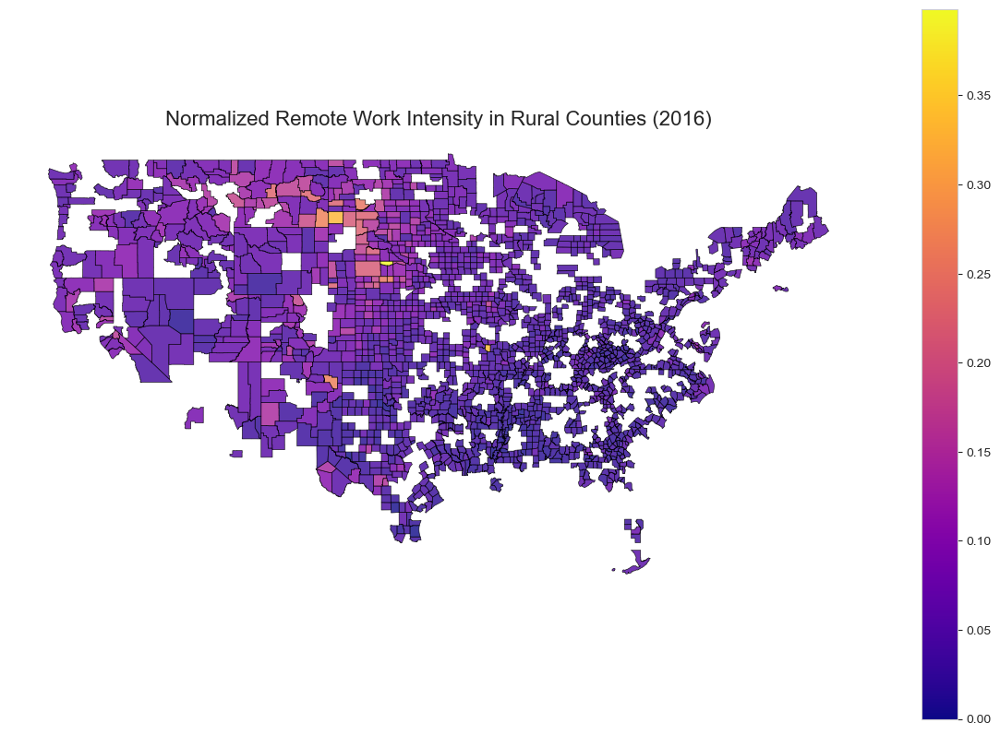

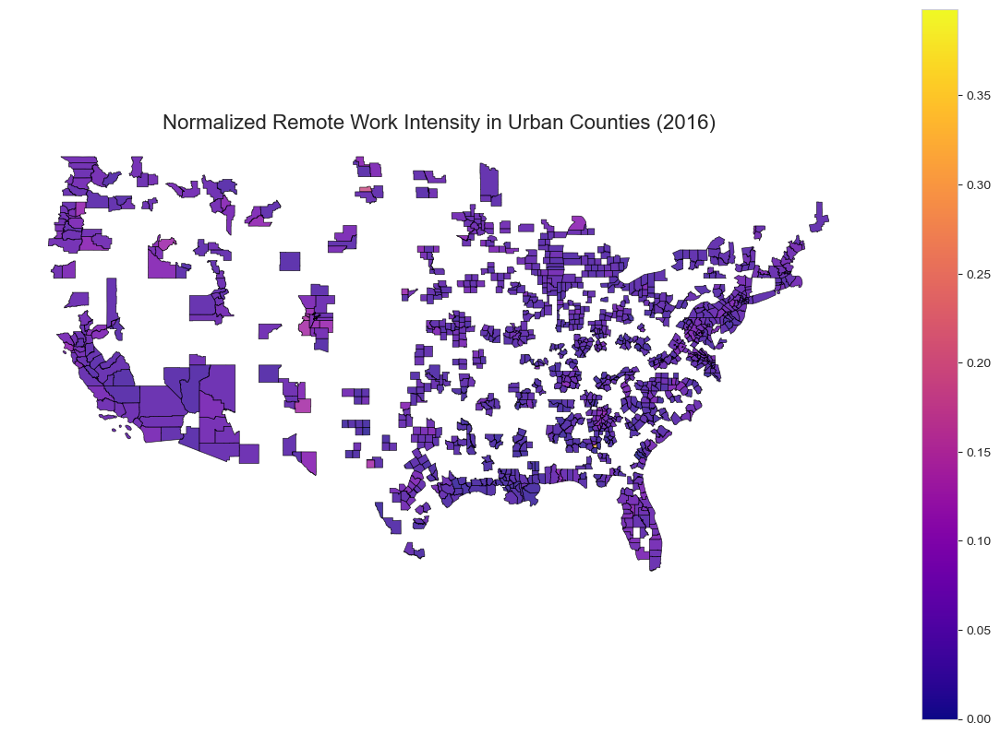

Processing data for year 2017...



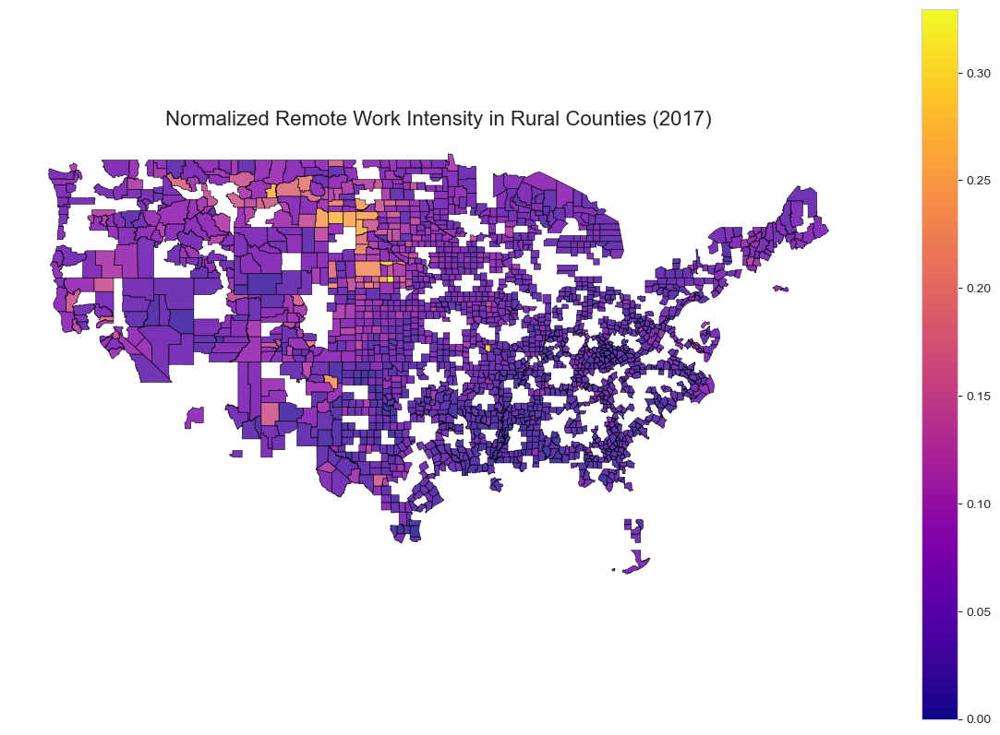

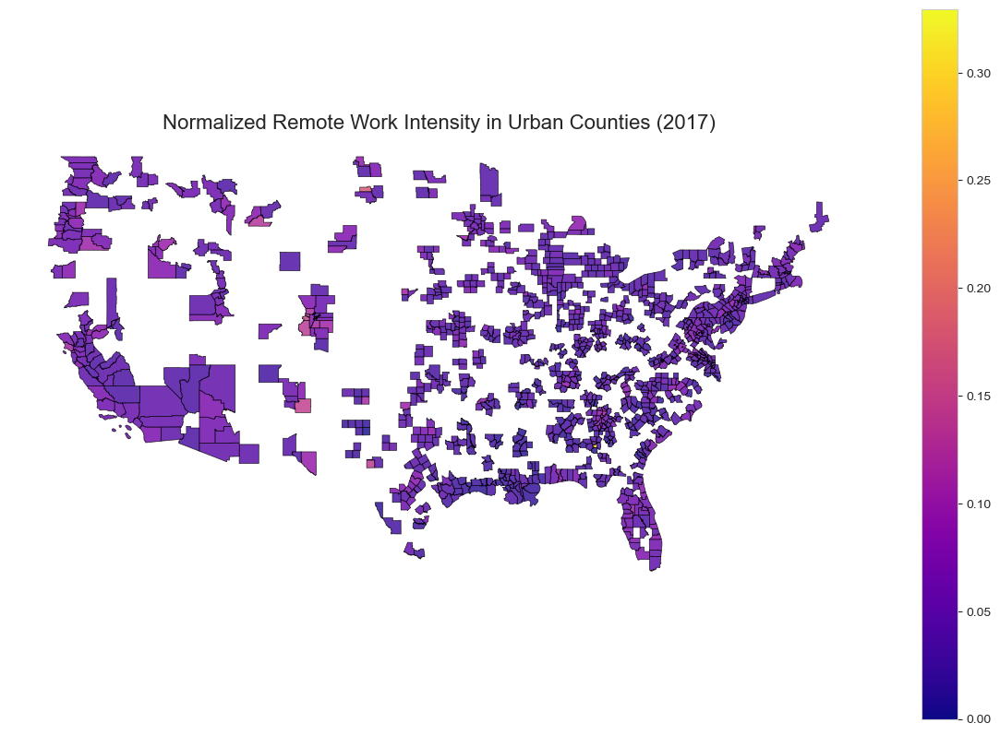

Processing data for year 2018...



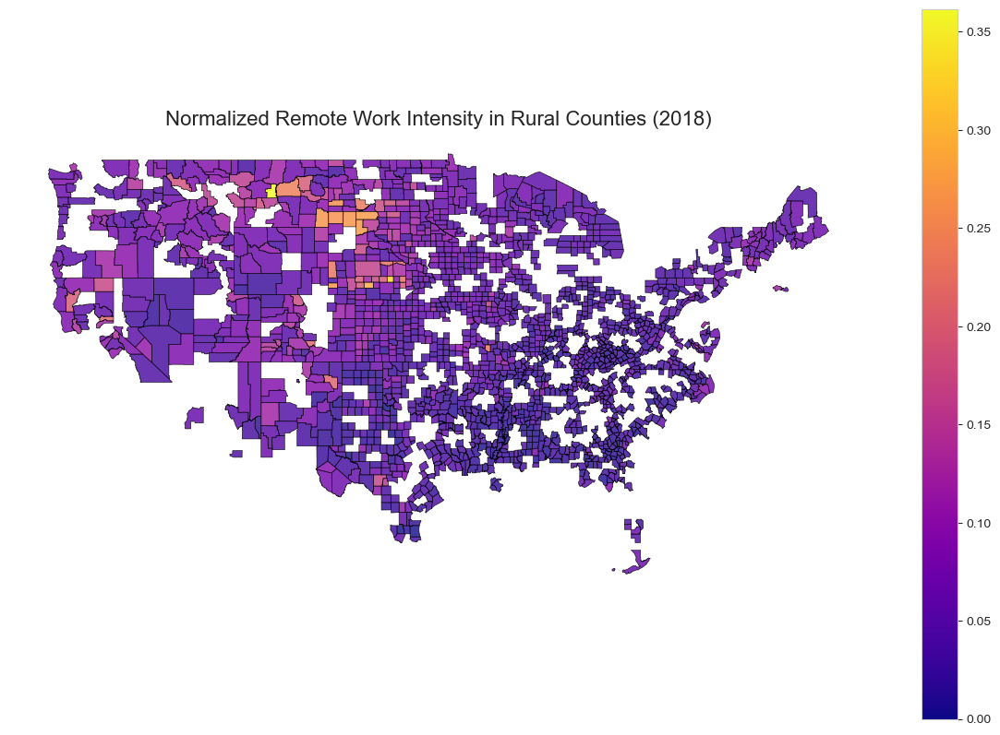

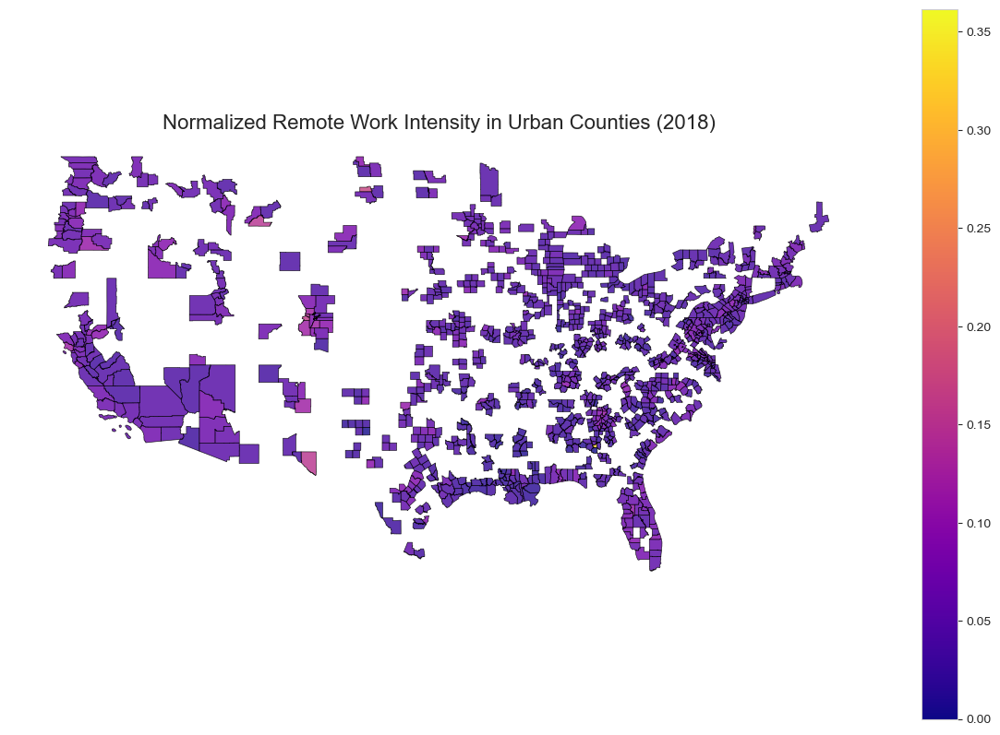

Processing data for year 2019...



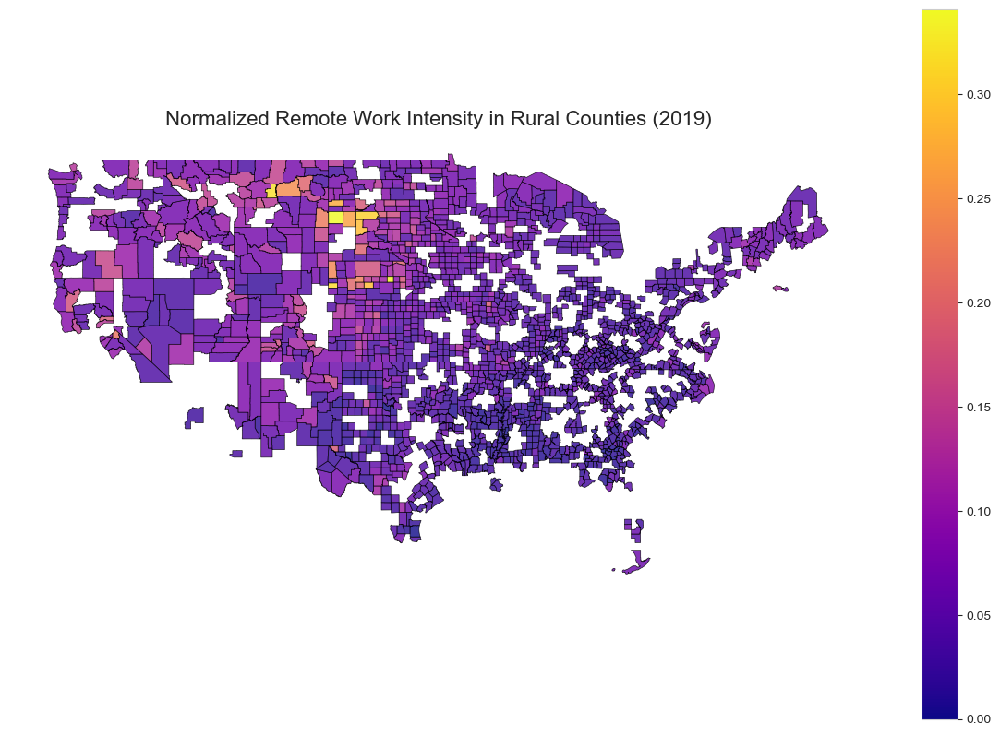

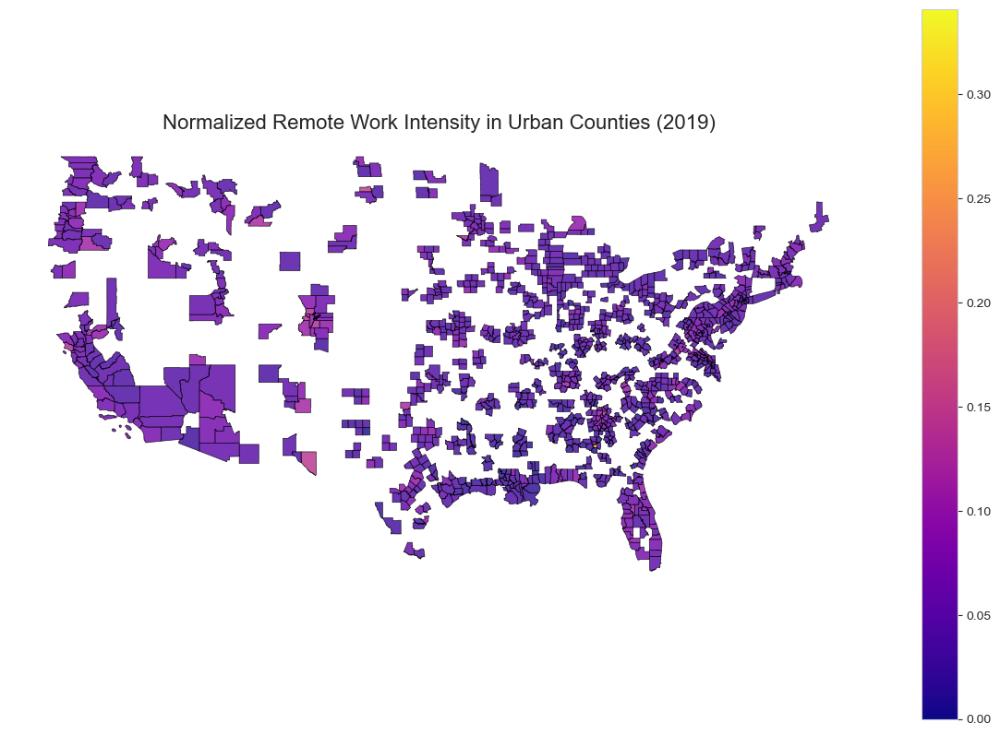

Processing data for year 2020...



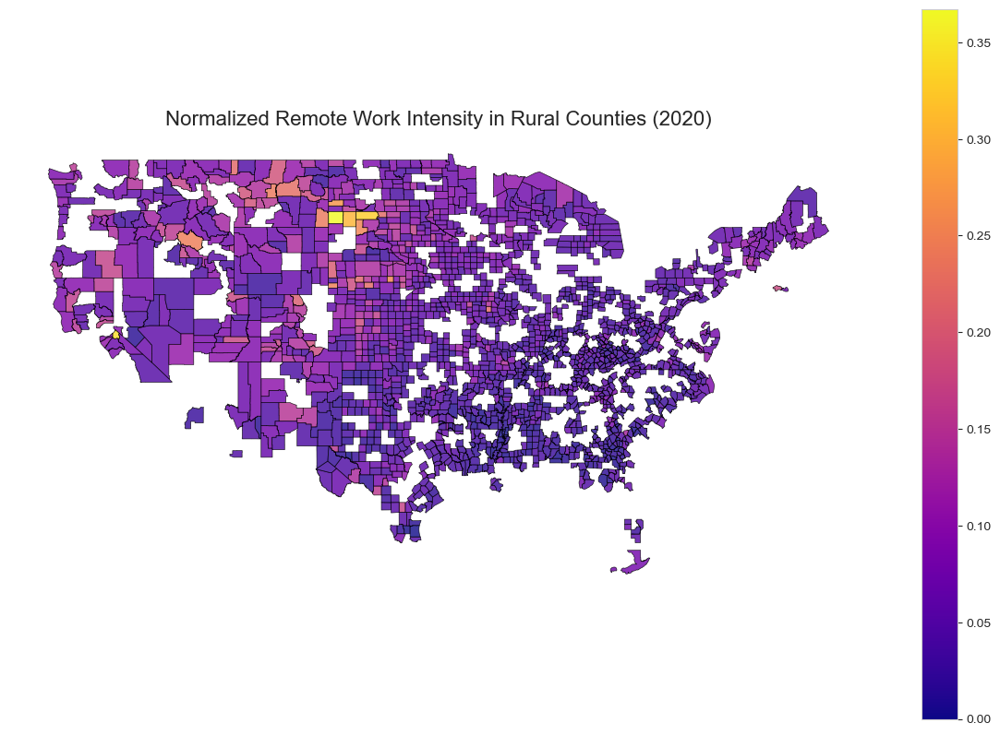

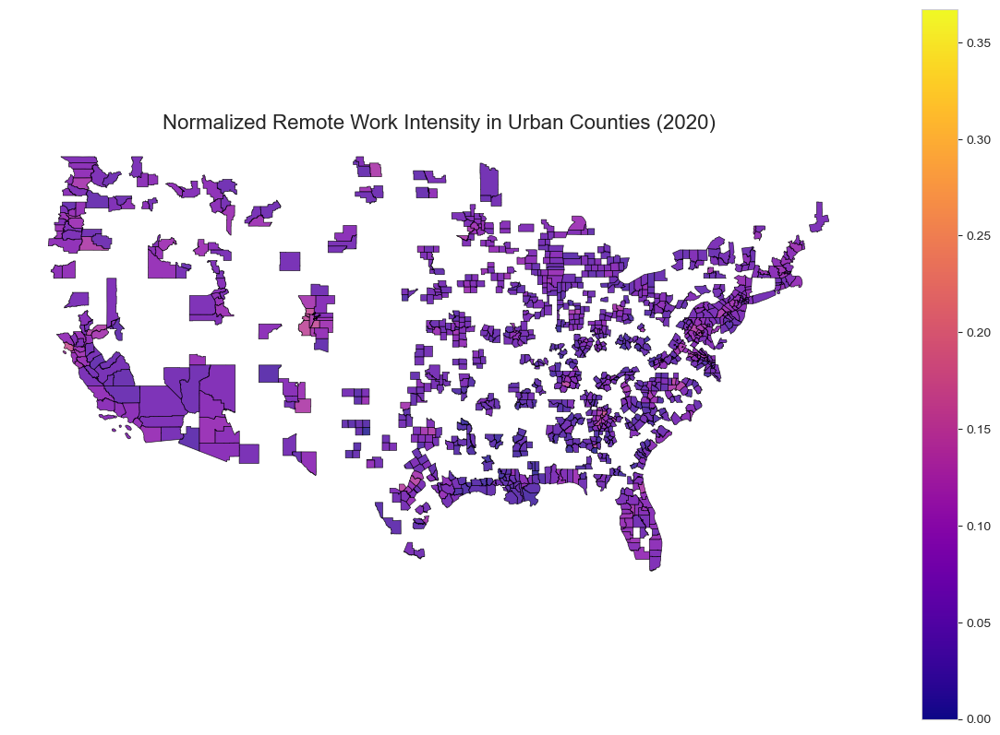

Processing data for year 2021...



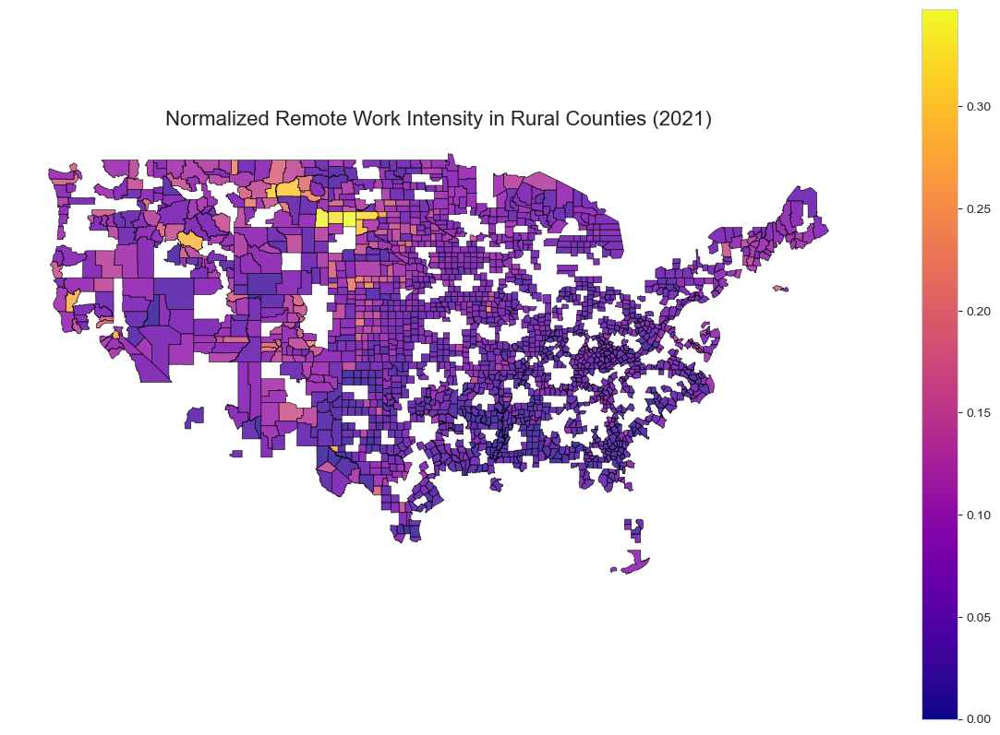

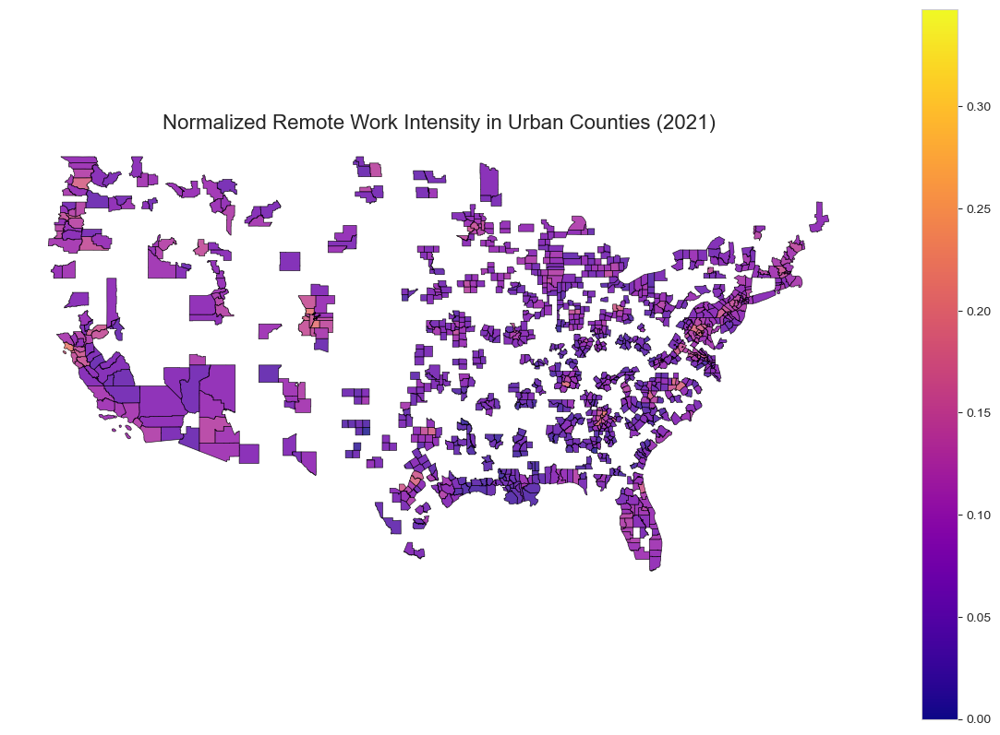

Processing data for year 2022...



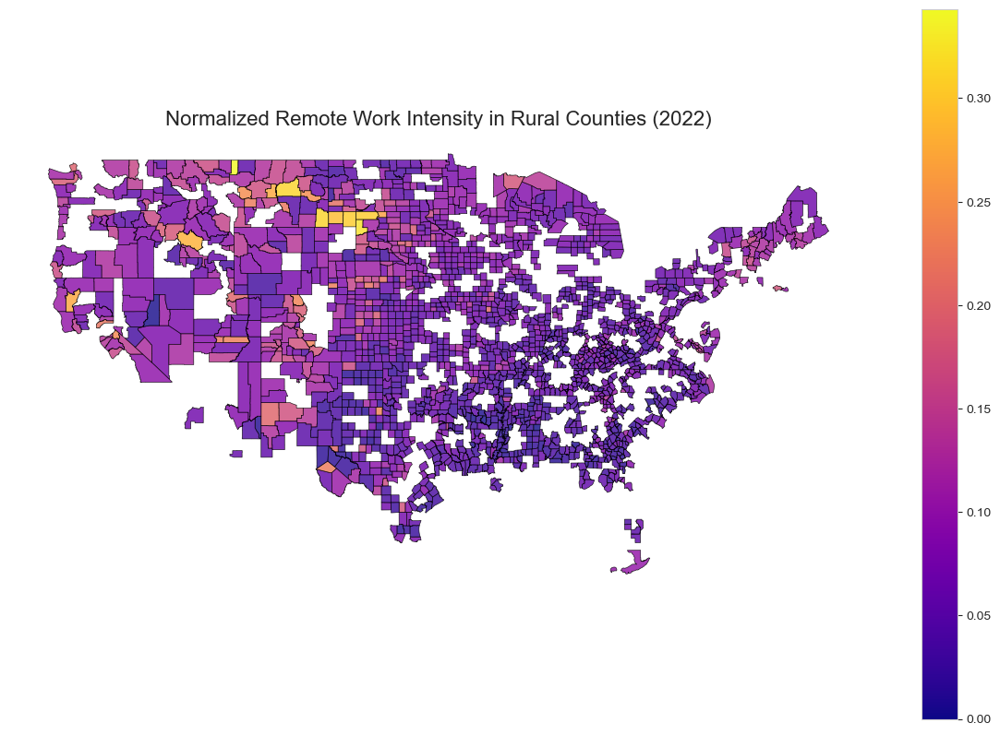

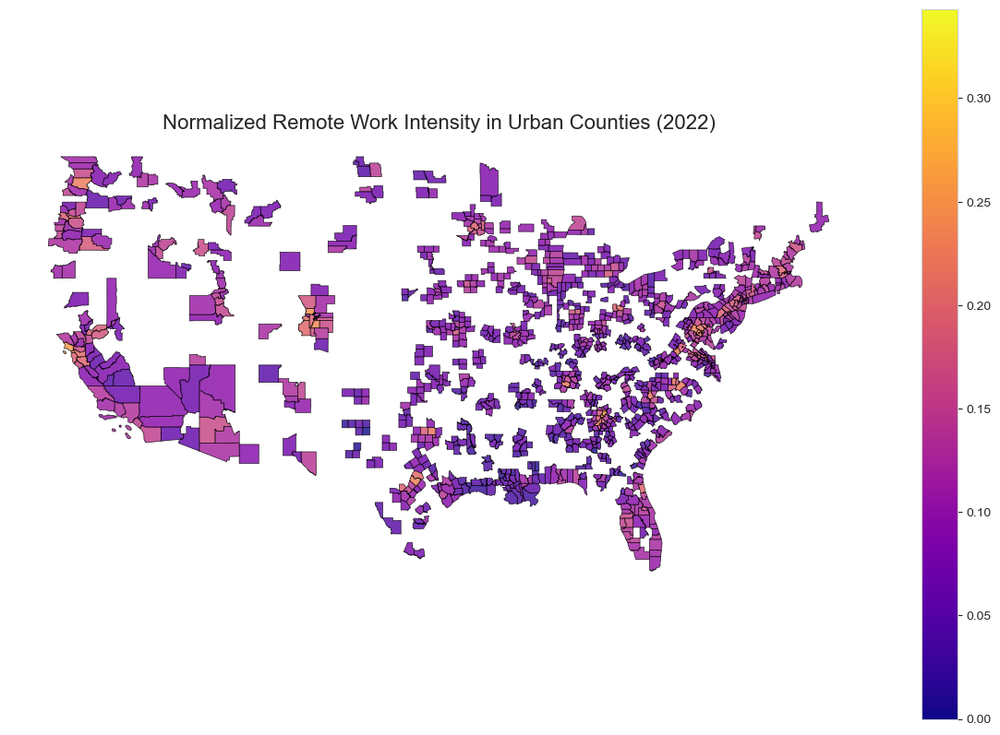

Processing data for year 2023...
Failed to fetch data for 2023. Status code: 404
No ACS data fetched for 2023. Skipping...
All years processed and combined into 'remote_work_comparisons_2016_2023.csv'


In [18]:


def fetch_acs_data(year, api_key):
    base_url = f"https://api.census.gov/data/{year}/acs/acs5"
    params = {
        "get": "NAME,B08006_017E,B08006_001E",
        "for": "county:*",
        "in": "state:*",
        "key": api_key }
    response = requests.get(base_url, params=params)
    if response.status_code == 200:
        data = response.json()
        columns = data[0]
        df = pd.DataFrame(data[1:], columns=columns)
        df["B08006_017E"] = pd.to_numeric(df["B08006_017E"], errors="coerce")
        df["B08006_001E"] = pd.to_numeric(df["B08006_001E"], errors="coerce")
        df["state+county"] = df["state"] + df["county"]
        df["normalized_remote_hours"] = df["B08006_017E"] / df["B08006_001E"]
        return df
    else:
        print(f"Failed to fetch data for {year}. Status code: {response.status_code}")
        return pd.DataFrame()

def load_rural_urban_data(file_path):
    # URL of the Excel file on GitHub
    file_url = 'https://github.com/ArcturusMajere/finalgeog/raw/main/Ruralurbancontinuumcodes2023.xlsx'
    response = requests.get(file_url)
    file_content = BytesIO(response.content)
    
    data = pd.ExcelFile(file_content)
    df = pd.read_excel(data, dtype={"FIPS": str})
    df["rural_urban"] = df["RUCC_2023"].apply(lambda x: "rural" if x >= 4 else "urban")
    print()
    return df[["FIPS", "rural_urban"]]

def aggregate_remote_work_intensity(gdf):
    rural_data = gdf[gdf["rural_urban"] == "rural"]
    urban_data = gdf[gdf["rural_urban"] == "urban"]
    rural_total_remote_work = rural_data["B08006_017E"].sum()
    rural_total_work = rural_data["B08006_001E"].sum()
    urban_total_remote_work = urban_data["B08006_017E"].sum()
    urban_total_work = urban_data["B08006_001E"].sum()
    return pd.DataFrame({
        "Category": ["Rural", "Urban"],
        "Total Remote Work Hours": [rural_total_remote_work, urban_total_remote_work],
        "Total Work Hours": [rural_total_work, urban_total_work],
        "Normalized Remote Work Intensity": [
            rural_total_remote_work / rural_total_work if rural_total_work > 0 else 0,
            urban_total_remote_work / urban_total_work if urban_total_work > 0 else 0
        ] })

def map_remote_work_intensity(gdf, column, title, vmin, vmax):
    import matplotlib.pyplot as plt
    fig, ax = plt.subplots(figsize=(15, 10))
    gdf.plot(
        column=column,
        cmap="plasma",
        linewidth=0.5,
        edgecolor='black',
        ax=ax,
        legend=True,
        alpha=0.8,
        vmin=vmin,
        vmax=vmax
    )
    ax.set_title(title, fontsize=16)
    ax.axis('off')
    plt.show()



def main():
    years = range(2016, 2024)  # Iterate over years 2016 to 2023
    all_comparisons = []

    for year in years:
        print(f"Processing data for year {year}...")
        
        # Fetch ACS data for the current year
        acs_data = fetch_acs_data(year, api_key)
        if acs_data.empty:
            print(f"No ACS data fetched for {year}. Skipping...")
            continue

        # Load rural-urban classification data
        rural_urban_df = load_rural_urban_data('Ruralurbancontinuumcodes2023.xlsx')
        acs_data = acs_data.merge(rural_urban_df, left_on="state+county", right_on="FIPS", how="left")
        if acs_data.empty:
            print(f"Failed to merge ACS data with rural-urban classification for {year}. Skipping...")
            continue

        # Fetch county geometries and merge with ACS data
        counties_df = counties(year=year, cache=True)
        counties_df["GEOID"] = counties_df["STATEFP"] + counties_df["COUNTYFP"]
        conus = counties_df[~counties_df['STATEFP'].isin(['02', '15', '72'])]  # Exclude non-CONUS states
        gdf = conus.merge(acs_data, left_on="GEOID", right_on="state+county", how="left")
        if gdf.empty:
            print(f"Failed to merge ACS data with county geomefor {year}. Skipping...")
            continue

        # Aggregate remote work intensity and save comparison
        comparison_df = aggregate_remote_work_intensity(gdf)
        comparison_df["Year"] = year  # Add year column for tracking
        all_comparisons.append(comparison_df)

        # Save data and generate maps for rural and urban counties
        comparison_df.to_csv(f"remote_work_comparison_{year}.csv", index=False)
        rural_gdf = gdf[gdf["rural_urban"] == "rural"]
        urban_gdf = gdf[gdf["rural_urban"] == "urban"]
        vmin = min(gdf["normalized_remote_hours"].min(), 0)
        vmax = gdf["normalized_remote_hours"].max()
        map_remote_work_intensity(rural_gdf, "normalized_remote_hours", f"Normalized Remote Work Intensity in Rural Counties ({year})", vmin, vmax)
        map_remote_work_intensity(urban_gdf, "normalized_remote_hours", f"Normalized Remote Work Intensity in Urban Counties ({year})", vmin, vmax)
    
    # Combine all years' comparisons into a single DataFrame
    if all_comparisons:
        combined_comparisons = pd.concat(all_comparisons, ignore_index=True)
        combined_comparisons.to_csv("remote_work_comparisons_2016_2023.csv", index=False)
        print("All years processed and combined into 'remote_work_comparisons_2016_2023.csv'")
    else:
        print("No valid data processed for the given years.")

main()



# Section 5
## Remote Work Dashboard: State Aggregation Animation

The `RemoteWorkDashboard` class is designed to facilitate the exploration and visualization of remote work trends across U.S. states using data from the American Community Survey (ACS) accessed via the U.S. Census Bureau API.

## Class Structure and Methods

### `__init__(self, api_key)`
- Initializes the dashboard with an API key for accessing the Census API.
- The `data` attribute is initialized to `None` and will store the fetched data as a DataFrame.

### `fetch_remote_work_data(self, available_years)`
- Fetches remote work data for each state and year specified in `available_years`.
- Uses the Census API to retrieve total workers (`B08006_001E`) and remote workers (`B08006_017E`) for each state.
- Calculates the percentage of remote workers and stores results in a DataFrame.
- Handles API rate limits by pausing for 1 second between requests to prevent hitting the rate limit.
- Any errors during data fetching are printed, and data collection continues for other states and years.

### `plot_choropleth_map(self, year, geojson_url, output_dir='maps')`
- Generates a choropleth map for a given year using Folium.
- Maps are saved in the specified `output_dir` and displayed inline in Jupyter using an iframe.
- The color scale `YlOrRd` visually represents the percentage of remote workers.

### `plot_all_maps(self, years, geojson_url)`
- Iterates over specified years to generate and display choropleth maps.
- Ensures data is fetched before attempting to plot to avoid errors.

### `get_summary_stats(self)`
- Aggregates the fetched data to compute average, minimum, and maximum percentages of remote workers, as well as totals for remote and all workers by year.
- Returns these summary statistics as a DataFrame for easy viewing and analysis.

## Execution

The `main` function:
- Instantiates the dashboard with an API key.
- Specifies the years for which data should be fetched and visualized.
- Fetches the data, plots choropleth maps for each year, and retrieves summary statistics.
- Prints the summary statistics to provide a quick overview of remote work trends over the specified years.

This structured approach allows for a comprehensive analysis of remote work dynamics, providing both visual and quantitative insights.

## Conclusions: States with Higher Remote Work Levels and Trends

## States with Higher Remote Work Levels
1. **Western States**:
   - States like **Colorado**, **Utah**, and **Washington** consistently exhibit higher percentages of remote workers.
   - These states have strong tech industries and well-established digital infrastructure, making remote work more feasible.

2. **Northeastern States**:
   - **Massachusetts**, **New York**, and **Connecticut** have higher remote work adoption rates.
   - These states host numerous knowledge-based industries such as finance, consulting, and education, which transitioned more easily to remote work.

3. **Midwestern and Southern States**:
   - Remote work percentages are generally lower in the Midwest and South, with exceptions such as **Texas** (due to its growing tech and business hubs).
   - States like **Mississippi**, **Alabama**, and **Arkansas** consistently exhibit lower adoption rates, likely due to economies focused on manual and on-site industries.

## Trends in Remote Work
1. **Pre-Pandemic Trends (2010–2019)**:
   - Remote work adoption grew gradually, with tech-heavy states (e.g., Colorado, Washington, and Massachusetts) leading the trend.
   - Western states exhibited the highest rates due to their early investments in broadband and tech-focused economies.

2. **Pandemic-Driven Growth (2020–2022)**:
   - The COVID-19 pandemic dramatically accelerated remote work adoption across all states.
   - Western states (e.g., California, Oregon) and the Northeast saw significant jumps, with some states experiencing remote work percentages exceeding 15%.
   - Growth rates were highest in states with larger urban populations, as major companies shifted to remote work policies.

3. **Stable Low-Adoption Regions**:
   - States in the Midwest and South with lower broadband access and economies reliant on manufacturing and agriculture (e.g., Alabama, Mississippi) consistently lagged in remote work adoption.
   - These states demonstrated slower growth even during the pandemic, maybe reveealing structural economic barriers.

4. **Urban vs. Rural Dynamics**:
   - Urban-centric states like  New York &California saw higher initial adoption rates.
   - Rural areas, even within high-adoption states, lagged behind due to limited access to digital infrastructure.


In [23]:
class RemoteWorkDashboard:
    def __init__(self, api_key):
        self.api_key = api_key
        self.data = None
    
    def fetch_remote_work_data(self, available_years):
        c = Census(self.api_key)
        all_data = []
        for year in available_years:
            for state in states.STATES:
                try:
                    data = c.acs5.state(('NAME', 'B08006_001E', 'B08006_017E'), state.fips, year=year)
                    for row in data:
                        total_workers = int(row['B08006_001E'])
                        remote_workers = int(row['B08006_017E'])
                        percentage_remote = (remote_workers / total_workers) * 100
                        all_data.append({
                            "State": state.name,
                            "Year": year,
                            "Total Workers": total_workers,
                            "Remote Workers": remote_workers,
                            "Percentage Remote": round(percentage_remote, 2) })
                except Exception as e:
                    print(f"Error fetching data for {state.name}, year {year}: {e}")
                time.sleep(1)  # Respectful pause to avoid hitting API rate limits
        self.data = pd.DataFrame(all_data)
        return self.data
    
    def plot_choropleth_map(self, year, geojson_url, output_dir='maps'):
        os.makedirs(output_dir, exist_ok=True)
        year_data = self.data[self.data["Year"] == year]
        m = folium.Map(location=[37.8, -96], zoom_start=4)
        folium.Choropleth(
            geo_data=geojson_url,
            name=f'Remote Work {year}',
            data=year_data,
            columns=['State', 'Percentage Remote'],
            key_on='feature.properties.name',
            fill_color='YlOrRd',
            fill_opacity=0.7,
            line_opacity=0.2,
            legend_name=f'Percentage of Remote Workers ({year})'
        ).add_to(m)
        folium.LayerControl().add_to(m)
        output_file = os.path.join(output_dir, f'remote_work_map_{year}.html')
        m.save(output_file)
        display(HTML(f'<iframe src="{output_file}" width="100%" height="500px"></iframe>'))

    def plot_all_maps(self, years, geojson_url):
        if self.data is None:
            raise ValueError("Please fetch data first using fetch_remote_work_data()")
        
        for year in years:
            clear_output(wait=True)  # Clear the previous map display
            print(f"Displaying map for {year}")
            self.plot_choropleth_map(year, geojson_url)
            time.sleep(5)  # Pause to allow map display

    def get_summary_stats(self):
        if self.data is None:
            raise ValueError("Please fetch data first using fetch_remote_work_data()")
        summary = self.data.groupby('Year').agg({
            'Percentage Remote': ['mean', 'min', 'max'],
            'Remote Workers': ['sum'],
            'Total Workers': ['sum']
        })
        summary.columns = ['Avg Remote %', 'Min Remote %', 'Max Remote %', 'Total Remote Workers', 'Total Workers']
        summary = summary.reset_index()
        return summary


def main():
    dashboard = RemoteWorkDashboard(api_key)
    available_years = list(range(2010, 2023))
    geojson_url = 'https://raw.githubusercontent.com/PublicaMundi/MappingAPI/master/data/geojson/us-states.json'
    data = dashboard.fetch_remote_work_data(available_years)
    dashboard.plot_all_maps(available_years, geojson_url)
    summary_stats = dashboard.get_summary_stats()
    print("\nRemote Work Summary Statistics:")
    print(summary_stats)

main()


KeyboardInterrupt: 

# Section 6
## Introduction to the WFH Dataset

This dataset, derived from the study **"Why Working From Home Will Stick" by Barrero, Bloom, and Davis (2021)**, provides a comprehensive analysis of work-from-home (WFH) trends across U.S. cities, tracking WFH percentages over time from the pre-COVID era through the pandemic and beyond. It covers major metropolitan areas and key economic hubs, offering granular insights into the dynamics of WFH adoption. This data is invaluable for understanding the spatial, temporal, and economic implications of remote work trends.

The study's data is crucial for discussions on future work trends, urban-rural migration patterns, and economic restructuring due to remote work practices. Licensed under the CC-BY 4.0, it encourages use in research and policy analysis.

## Algorithm Description

### Data Preprocessing:
- Convert date columns to datetime format for temporal analysis.
- Extract unique years for annual comparisons.
- Normalize WFH percentages across cities for consistent scaling in visual representations.

### Mapping Algorithm:
- Utilize Cartopy for geographic plotting, creating bubble maps for each year.
- Assign geographic coordinates to each city.
- Scale bubble sizes according to WFH percentages and apply vibrant color gradients (using the plasma colormap) to highlight variations.

### Trend Analysis:
- Extract and plot WFH percentages for each city over time.
- Use distinct colors for each city on line charts for clear differentiation.
- Enhance charts with legends, formatted axes, and annotations for better interpretability.

## Data Summary

**Temporal Coverage:**
- The data spans from 2020 to 2024, capturing pre-pandemic baselines, pandemic peaks, and post-pandemic stabilization periods.

**City-Level Insights:**
- The dataset includes major metropolitan areas such as New York, Los Angeles, and the Bay Area, allowing comparisons across diverse urban environments with varying levels of WFH adoption.

**Key Metrics:**
- **WFH percentage:** Proportion of full paid working days spent working from home.
- **Time binning:** Monthly and annual data provide a detailed basis for visualizing trends.

**Observations:**
- WFH percentages peaked during the early pandemic phase but have since declined, stabilizing at levels higher than pre-pandemic norms.
- Cities like the Bay Area and New York consistently show higher rates of WFH adoption.

# Summary

This dataset is a robust resource for exploring the trajectory of remote work in the United States, highlighting significant shifts towards WFH during the COVID-19 pandemic and the subsequent adjustment periods. It provides researchers and policymakers with a powerful tool to study urban planning, labor market dynamics, and economic restructuring in the face of changing work environments.

The data, sourced from the Survey of Working Arrangements and Attitude, includes over 200,000 observations since May 2020, capturing a detailed portrait of the workforce's evolution towards remote work. As of September 2024, about 28% of paid days in the U.S. were spent working from home, indicating a stabilization at a significantly higher level compared to pre-pandemic norms.

Significantly, the pandemic accelerated the adoption of WFH by almost 40 years of what would have been expected based on pre-pandemic trends. By mid-2024, hybrid work models had become the norm among those able to work from home, with 27% of employees in such arrangements, underscoring the persistent demand and acceptance of flexible work setups.

## Conclusions

The data's origin in the seminal work by Barrero, Bloom, and Davis ensures its academic rigor and relevance to ongoing discussions about the future of work. By combining geographic, temporal, and economic dimensions, it serves as a cornerstone for analyzing the impact of remote work on cities and beyond. 

Employers now face the challenge of aligning their remote work policies with employee preferences, where a notable gap still exists. The research shows a discrepancy of approximately 0.6 days between how often employees wish to work from home and the opportunities their employers provide. This highlights a critical area for policy intervention and organizational adjustment.

Furthermore, the prevalence of remote work varies significantly by sector, with high adoption in finance, technology, and professional services, contrasting sharply with sectors like agriculture and construction. This sectoral disparity suggests potential areas for future growth in remote work capabilities and infrastructure, particularly in less represented industries.

Overall, this dataset not only documents the profound shifts in work arrangements induced by the pandemic but also provides a foundation for anticipating future trends in the labor market and urban planning strategies. It is a vital resource for understanding how remote work can shape economic, spatial, and occupational landscapes in the post-pandemic world.



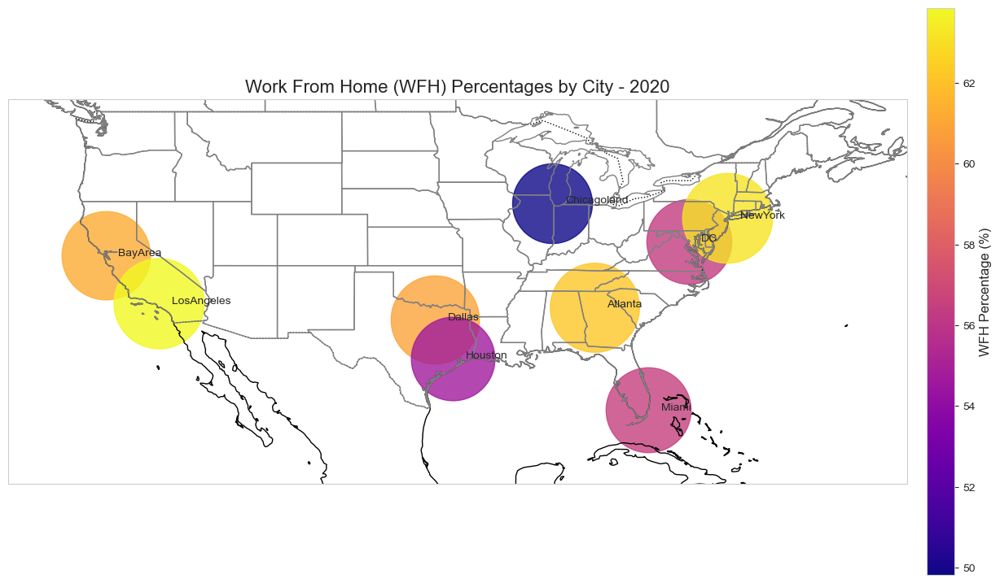

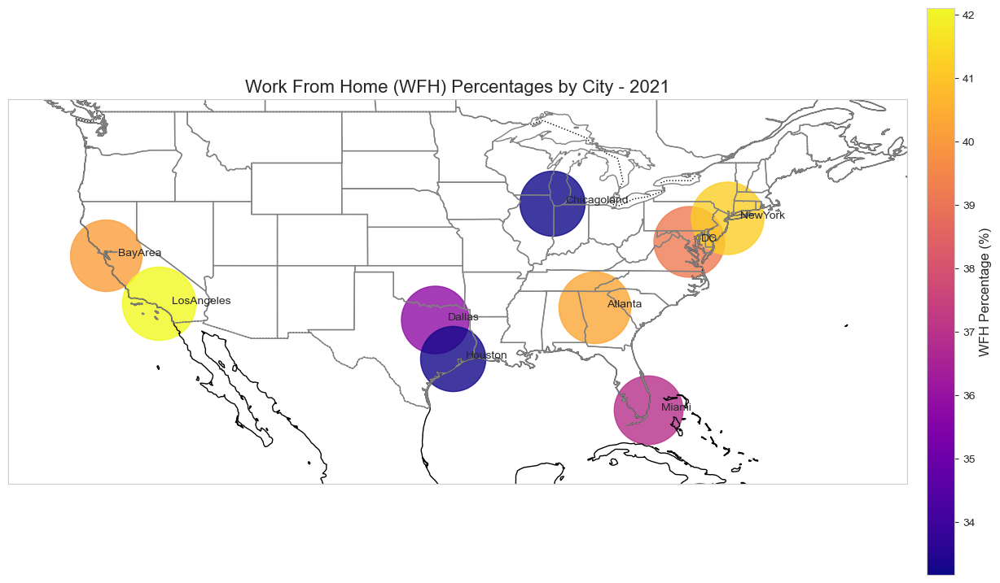

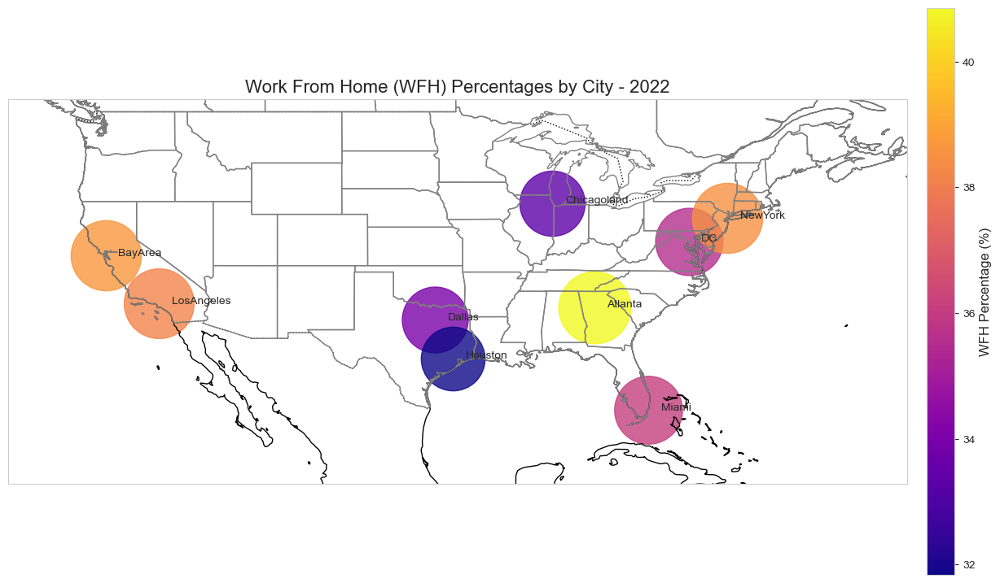

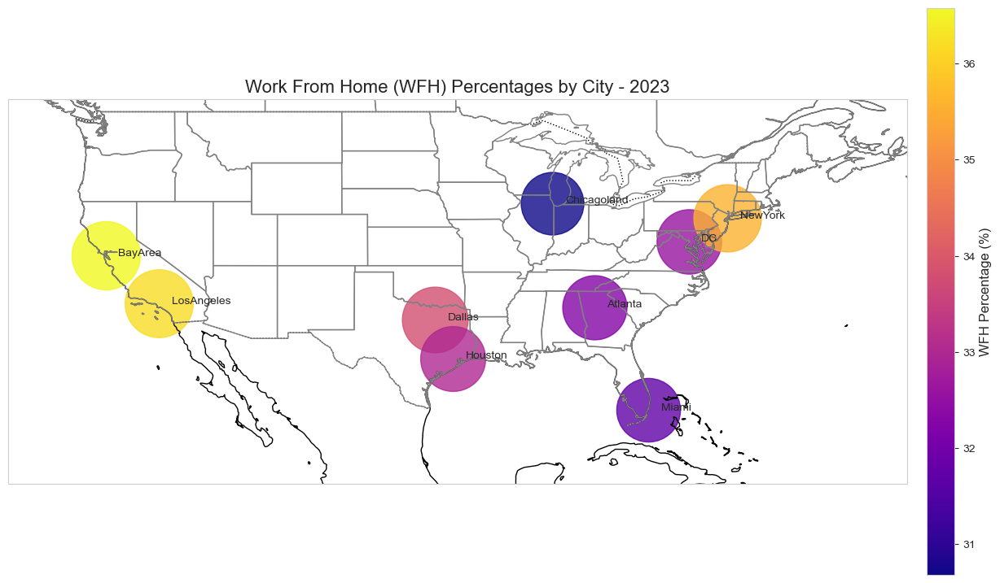

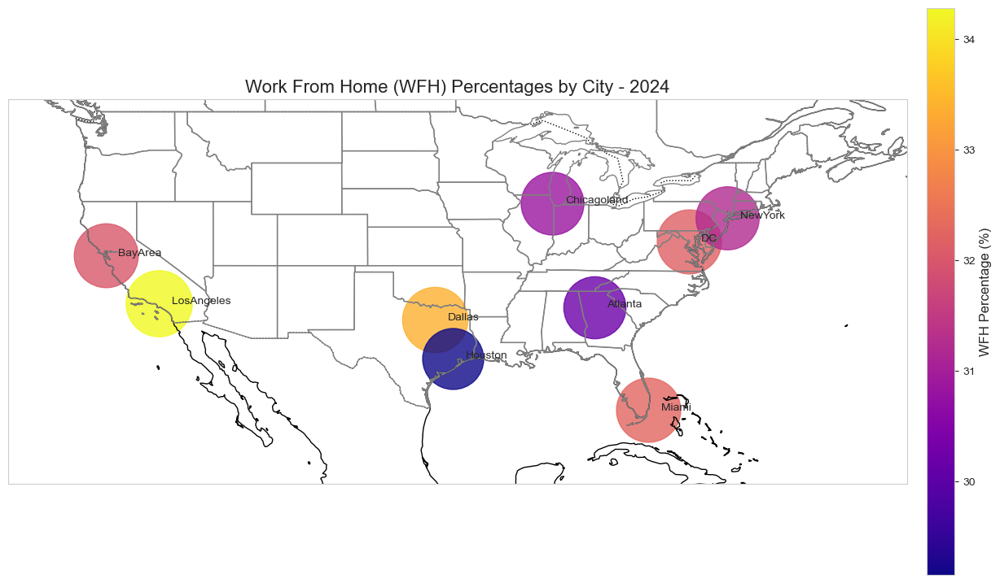

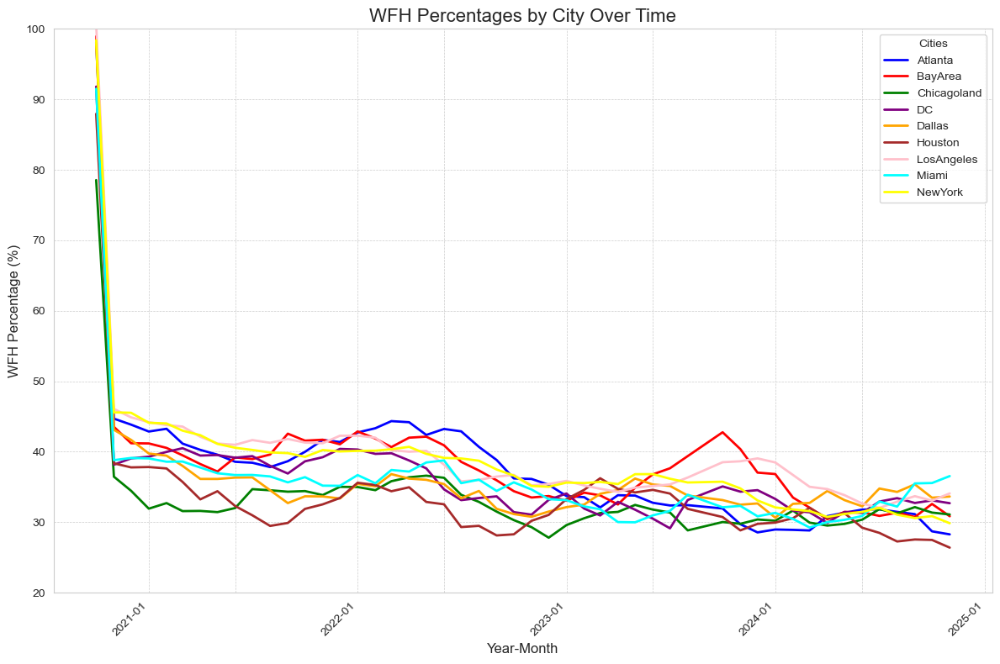

In [22]:

file_url = 'https://github.com/ArcturusMajere/finalgeog/raw/main/wfh.xlsx'
response = requests.get(file_url)
file_content = BytesIO(response.content)
wfh_data = pd.ExcelFile(file_content)
wfh_by_city = wfh_data.parse('WFH by city')
wfh_by_city['date'] = pd.to_datetime(wfh_by_city['date'])
cities = ['Atlanta', 'BayArea', 'Chicagoland', 'DC', 'Dallas', 'Houston', 'LosAngeles', 'Miami', 'NewYork']
coords = {
    'Atlanta': (-84.3880, 33.7490),
    'BayArea': (-122.4194, 37.7749),
    'Chicagoland': (-87.6298, 41.8781),
    'DC': (-77.0369, 38.9072),
    'Dallas': (-96.7970, 32.7767),
    'Houston': (-95.3698, 29.7604),
    'LosAngeles': (-118.2437, 34.0522),
    'Miami': (-80.1918, 25.7617),
    'NewYork': (-74.0060, 40.7128)}


years = wfh_by_city['date'].dt.year.unique()
bubble_scaling_factor = 100  # Adjust as needed
cmap = get_cmap('plasma')  # Use 'plasma' for a vibrant, distinguishable colormap
for year in years:
    fig, ax = plt.subplots(figsize=(15, 10), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.add_feature(cfeature.STATES, edgecolor='gray')
    ax.set_extent([-130, -60, 20, 50], crs=ccrs.PlateCarree())  # Map extent for the US
    year_data = wfh_by_city[wfh_by_city['date'].dt.year == year]
    wfh_values = []
    for city in cities:
        column_name = f'wfhcovid_series_MA6_{city}'
        if column_name in year_data.columns:
            value = year_data[column_name].mean()
            if value and value > 0:
                wfh_values.append(value)
    norm = Normalize(vmin=min(wfh_values), vmax=max(wfh_values))
    for city in cities:
        lon, lat = coords[city]
        column_name = f'wfhcovid_series_MA6_{city}'
        if column_name in year_data.columns:
            value = year_data[column_name].mean()  
            if value and value > 0:  
                color = cmap(norm(value))
                ax.scatter(
                    lon, lat, s=value * bubble_scaling_factor, color=color, alpha=0.8, transform=ccrs.PlateCarree())
                ax.text(lon + 1, lat, city, fontsize=10, transform=ccrs.PlateCarree())

    sm = ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    cbar = plt.colorbar(sm, ax=ax, orientation='vertical', pad=0.02, fraction=0.03)
    cbar.set_label("WFH Percentage (%)", fontsize=12)
    ax.set_title(f"Work From Home (WFH) Percentages by City - {year}", fontsize=16)
    plt.show()

    
fig, ax = plt.subplots(figsize=(12, 8))

city_colors = {
    'Atlanta': 'blue',
    'BayArea': 'red',
    'Chicagoland': 'green',
    'DC': 'purple',
    'Dallas': 'orange',
    'Houston': 'brown',
    'LosAngeles': 'pink',
    'Miami': 'cyan',
    'NewYork': 'yellow'}

for city in cities:
    column_name = f'wfhcovid_series_MA6_{city}'
    if column_name in wfh_by_city.columns:
        city_data = wfh_by_city[['date', column_name]].dropna()
        ax.plot(
            city_data['date'],
            city_data[column_name],
            label=city,
            color=city_colors[city],
            linewidth=2  )


ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
ax.xaxis.set_major_locator(mdates.YearLocator()) 
ax.xaxis.set_minor_locator(mdates.MonthLocator(bymonth=[6])) 
plt.setp(ax.xaxis.get_majorticklabels(), rotation=45, ha="right") 
ax.set_ylim(20, 100)  
ax.set_yticks(range(20, 101, 10))  
ax.set_title("WFH Percentages by City Over Time", fontsize=16)
ax.set_xlabel("Year-Month", fontsize=12)
ax.set_ylabel("WFH Percentage (%)", fontsize=12)
ax.legend(loc='upper right', title="Cities", fontsize=10)
ax.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()

# Section 7

# Remote Work Data Analysis Application

## Introduction
This application is designed to retrieve and analyze state-level remote work data using the U.S. Census API. The tool focuses on calculating the percentage of workers who worked remotely for a specified state and year. This program is intended for use as part of a broader project, with the hosting platform for the front-end interface yet to be determined.

## Description
The `fetch_remote_work_data` function utilizes the U.S. Census API to fetch data from the American Community Survey (ACS). It calculates and prints the percentage of remote workers in the selected state and year.

### Key Features
- **API Integration**: Connects to the U.S. Census API to retrieve ACS data.
- **Customizable Queries**: Allows users to input a state abbreviation and year for focused analysis.
- **Dynamic Calculations**: Calculates the percentage of workers engaged in remote work based on ACS variables.
- **State-Specific Analysis**: Provides detailed insights into remote work trends by state and year.

### Code Explanation
1. **Function `fetch_remote_work_data`**:
   - Accepts an API key, state abbreviation, and year as inputs.
   - Uses the Census API client to query ACS data for the specified state and year.
   - Calculates the percentage of remote workers using the variables:
     - `B08006_001E`: Total number of workers.
     - `B08006_017E`: Number of remote workers.
   - Outputs the percentage of remote workers for the given state and year.

2. **Input Prompts**:
   - The program asks the user to input:
     - State abbreviation (e.g., `CA` for California).
     - Year (e.g., `2022`).

3. **Execution**:
   - Outputs remote work data, including the state name, year, and the percentage of workers who worked remotely.

### Example Usage
```plaintext
Enter the state abbreviation (e.g., 'CA' for California): CA
Enter the year (e.g., 2022): 2022
Remote Work Data for CA in 2022:
California (2022): 12.34% of workers worked remotely.



In [21]:
#  APP for front end hosting to be determined

def fetch_remote_work_data(api_key, state_abbreviation, year):
    c = Census(api_key)
    state_fips = states.lookup(state_abbreviation).fips
    data = c.acs5.state(('NAME', 'B08006_001E', 'B08006_017E'), state_fips, year=year)
    print(f"Remote Work Data for {state_abbreviation} in {year}:\n")
    for row in data:
        total_workers = int(row['B08006_001E'])
        remote_workers = int(row['B08006_017E'])
        percentage_remote = (remote_workers / total_workers) * 100
        print(f"{row['NAME']} ({year}): {percentage_remote:.2f}% of workers worked remotely.")
if __name__ == "__main__":
    api_key = "2a2f8febfd3cdfeebbaaa1e54064cff81232875c"
    state_abbreviation = input("Enter the state abbreviation (e.g., 'CA' for California): ")
    year = int(input("Enter the year (e.g., 2022): "))
    fetch_remote_work_data(api_key, state_abbreviation, year)

Enter the state abbreviation (e.g., 'CA' for California): ID
Enter the year (e.g., 2022): 2019
Remote Work Data for ID in 2019:

Idaho (2019): 6.22% of workers worked remotely.


## Conclusion and Future Directions

The research conducted throughout this project has highlighted significant shifts in the workforce landscape influenced by the COVID-19 pandemic, particularly the surge in remote work. My very brief geostatistical analysis and Web GIS applications have provided a beginning view of how remote work trends have evolved from 2016 to 2023, emphasizing the disparities between urban and rural areas in adopting these changes.

### Key Findings

1. **Increase in Remote Work**: There has been a consistent increase in remote work across the United States, with a sharp spike observed in 2020 due to the pandemic. This trend stabilized but remained elevated compared to pre-pandemic levels, suggesting a permanent shift in work patterns.

2. **Urban vs. Rural Dynamics**: Urban areas have shown higher rates of remote work adoption compared to rural areas. This is partly due to the concentration of industries that can more easily transition to remote work, such as tech, finance, and professional services, in urban regions.

3. **Economic and Sectoral Shifts**: The economic impact of remote work has been profound, influencing not only work practices but also wage levels and sectoral employment. Industries that adapted quickly to remote work have seen less economic disruption and have even thrived during the pandemic.

4. **GIS and Geostatistical Insights**: The use of GIS technology and geostatistical methods has allowed for detailed spatial analysis of migration patterns and work trends, providing valuable insights for policymakers and businesses.


### Future Research Directions

While this project has provided foundational insights, there are several areas where further research could deepen understanding and inform more targeted actions:

- **Longitudinal Studies**: Continued monitoring of remote work trends over time will be crucial to understanding the long-term effects of the pandemic on work patterns. This includes the impact on employee productivity, company output, and economic health at the local and national levels.

- **Sector-Specific Analysis**: More granular research into how different sectors adapt to remote work can help identify which industries need more support and which are likely to thrive in a remote-first future.

- **Impact on Real Estate**: Investigating the impact of remote work on commercial and residential real estate markets can provide insights for investors and policymakers, particularly in terms of demand shifts and valuation changes.

- **Global Comparisons**: Expanding the scope of research to include global data could provide comparative insights that highlight best practices and innovative policies from around the world.

### Acknowledgments

I would like to extend my heartfelt thanks to Dr. Felix Liao for his  advice and counsel throughout the course of this research. Dr. Liao's expertise and thoughtful guidance have been helpful in shaping the direction and execution of this project.

# Bibliography of Datasets

This section lists all datasets used in the project, including their sources and descriptions.

---

## 1. **American Community Survey (ACS)**
- **Source**: U.S. Census Bureau
- **Description**: The ACS provides detailed demographic, social, economic, and housing data for U.S. counties. This project uses ACS data from 2016–2022 to analyze remote work trends, migration patterns, and wage levels.
- **Variables Used**:
  - `B08006_001E`: Total number of workers.
  - `B08006_017E`: Number of remote workers.
- **Access Method**: Retrieved using the `census` library and the Census API.
- **Website**: [ACS Data](https://www.census.gov/programs-surveys/acs)

---

## 2. **TIGRIS Shapefiles**
- **Source**: U.S. Census Bureau TIGER/Line Shapefiles
- **Description**: Geographic boundary files used to map U.S. counties and states. These shapefiles are essential for visualizing migration and remote work patterns across geospatial regions.
- **Access Method**: Accessed through the `pygris` library.
- **Website**: [TIGER/Line Shapefiles](https://www.census.gov/geographies/mapping-files/time-series/geo/tiger-line-file.html)

---

## 3. **PyGRIS County Boundaries**
- **Source**: Walker Data's PyGRIS Library
- **Description**: Provides pre-processed geographic shapefiles for counties in the U.S., optimized for use in Python. Used in this project for mapping and geospatial analysis.
- **Access Method**: Accessed via the `counties` function in the `pygris` library.
- **Website**: [PyGRIS](https://walker-data.com/pygris/)

---

## 4. **State and FIPS Codes**
- **Source**: `us` Python Library
- **Description**: Includes metadata such as state abbreviations and Federal Information Processing Standards (FIPS) codes, which are used to link Census data with geographic regions.
- **Access Method**: Accessed through the `us` library in Python.
- **Website**: [US Library](https://github.com/unitedstates/python-us)

---

## 5. **WFH Research**
- **Source**: Work-from-Home Research Project
- **Description**: Data on remote work trends and their economic and societal impacts. This project leverages insights from the WFH Research team to contextualize findings on remote work migration.
- **Access Method**: Insights and data accessed via the project website.
- **Website**: [WFH Research](https://wfhresearch.com/project-team/)

---

## 6. **USDA Rural Classifications**
- **Source**: U.S. Department of Agriculture Economic Research Service (ERS)
- **Description**: Data and classifications for defining rural and urban areas in the United States. These classifications are critical for analyzing urban-rural migration trends and understanding economic and demographic shifts.
- **Access Method**: Accessed via the USDA ERS website.
- **Website**: [USDA Rural Classifications](https://www.ers.usda.gov/topics/rural-economy-population/rural-classifications)

---

## 7. **Interactive GIS Data Tools**
- **Source**: Folium and Plotly Libraries
- **Description**: Generated maps and visualizations incorporating Census and TIGRIS shapefile data. Interactive maps allow exploration of migration and remote work trends.
- **Access Method**: Created programmatically within the Jupyter Notebook.
- **Tools**:
  - [Folium](https://python-visualization.github.io/folium/)
  - [Plotly](https://plotly.com/)



## Notes
- All datasets used are publicly accessible and were processed in compliance with the terms of use specified by their respective sources.
- For detailed information on preprocessing and integration, refer to the [Notebook](https://github.com/ArcturusMajere/finalgeog/blob/main/updated_final2.ipynb).


# THE END 
## thanks for your attention!